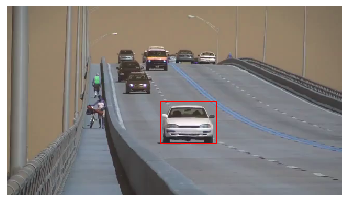

In [49]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.patches as patch

# get the first 2 frames from the video
video = cv2.VideoCapture('traffic.mp4')
if (video.isOpened()== False): 
  print("Error opening video stream or file")

success, org_img1 = video.read()
    
if not success:
    print('Error retrieving first frame')

success, org_img2 = video.read()
    
if not success:
    print('Error retrieving frame')

# get the bounding box dimentions and coordinates and display in plot
box_tr = (291, 181)
box_br = (399, 261)
box_h = box_br[1] - box_tr[1]
box_w = box_br[0] - box_tr[0]
rectangle = patch.Rectangle(box_tr,box_w,box_h,linewidth=1, edgecolor='r',facecolor='none')
fig = plt.figure()
ax = fig.add_subplot(111)
ax.imshow(org_img1)
ax.add_patch(rectangle)
plt.axis('off')
plt.show()


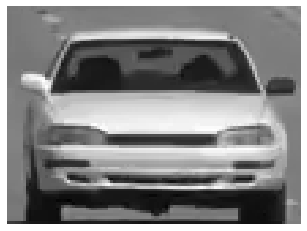

In [50]:
# change image to grayscale and segment the location of the viehicle according to the bounding box
img = cv2.cvtColor(org_img1, cv2.COLOR_BGR2GRAY)
img_seg = img[box_tr[1]:box_br[1],box_tr[0]:box_br[0]]

plt.figure()
plt.imshow(img_seg, cmap='gray')
plt.axis('off')
plt.show()

div by 0
div by 0


<function matplotlib.pyplot.show(*args, **kw)>

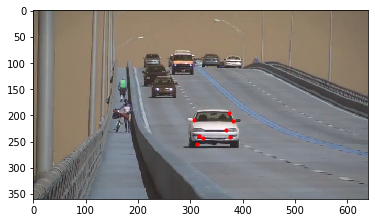

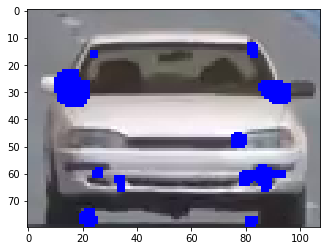

In [51]:
import scipy.ndimage as ndimage

def HarrisCornerDetection(img):
    # compute the gradients of the image using the sobel operator
    sobelx = cv2.Sobel(img, cv2.CV_64F,1,0,ksize=5)
    sobely = cv2.Sobel(img, cv2.CV_64F,0,1,ksize=5)
    
    # elementwise multiply the gradients to achieve Ixx, Iyy, and Ixy
    Ixx = np.multiply(sobelx, sobelx)
    Iyy = np.multiply(sobely, sobely)
    Ixy = np.multiply(sobelx, sobely)
    
    # get the shape of the image, and initialize the result matrix with zeros
    h, w = img.shape
    R = np.zeros(img.shape, dtype=np.float)
    
    # declare window size
    window_size = 9
    offset = (window_size-1)/2
    # loop over the image size in patches
    for x in range(int(offset), int(w-offset)):
        for y in range(int(offset), int(h-offset)):
            # get the values in a patch for Ixx, Iyy, Ixy
            Range_xx = Ixx[int(y-offset):int(y+offset+1), int(x-offset):int(x+offset+1)]
            Range_yy = Iyy[int(y-offset):int(y+offset+1), int(x-offset):int(x+offset+1)]
            Range_xy = Ixy[int(y-offset):int(y+offset+1), int(x-offset):int(x+offset+1)]
            
            # Sum over the patch for Ixx, Iyy, Ixy
            Sum_xx = np.sum(Range_xx)
            Sum_yy = np.sum(Range_yy)
            Sum_xy = np.sum(Range_xy)
            
            # Structure the results in a Structural Tensor and compute the eigen values
            arr = np.array([(Sum_xx, Sum_xy),(Sum_xy, Sum_yy)])
            eig = np.linalg.eigvals(arr)
            
            # Compute R
            power = pow((eig[0]+eig[1]),2)
            R[y,x] = (eig[0]*eig[1])-(0.04*power)
    
    # Compute the threshold of 0.17% of r_max
    r_max = np.amax(R)
    threshold = np.amax(R)*0.17
         
    # Loop over the image and put values > threshold as 255, and values < threshold as 0
    for i in range(0,h):
        for j in range(0,w):
            if R[i,j]>threshold:
                 R[i,j] = 255
            else:
                R[i,j] = 0
#     # Show the points identified from Harris Corner Detection
#     plt.figure()
#     plt.imshow(R, cmap='gray')
#     plt.colorbar()
#     plt.show  
    
    # get the contours of the rewsult from Harris and compute the centroids of the contours using moments
    R = R.astype(dtype=np.uint8)
    ret, thresh = cv2.threshold(R, 127, 255, 0)
    im2, contours, hierarchys = cv2.findContours(R, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    centroids = []
    x = []
    y = []
    for cnt in contours:
        M = cv2.moments(cnt)
        if M['m00'] == 0:
            print('div by 0')
        else:
            x.append(int(M['m10']/M['m00']))
            y.append(int(M['m01']/M['m00']))
        
    # output the centroids as the keypoints extracted from the image
    x = np.array(x)
    x_shape = x.shape
    x = x.reshape(x_shape[0],1)
    y = np.array(y)
    y_shape = y.shape
    y = y.reshape(y_shape[0],1)
    centroids = np.concatenate((x,y), axis=1)

    return centroids

# compute Harris Corner Detection
centr = HarrisCornerDetection(img_seg) 

# since the keypoints are extracted from the image segment, transform them to be suitable for the overall image
centr[:,0] = centr[:,0] + box_tr[0]
centr[:,1] = centr[:,1] + box_tr[1]

# plot the image with the keypoints
plt.figure()
plt.imshow(org_img1)
plt.scatter(x=centr[:,0], y=centr[:,1], c='r', marker='o', s=10)
plt.show

# compute openCV Harris Corner Detection
dst = cv2.cornerHarris(img_seg,9,5,0.04)
dst = cv2.dilate(dst,None)
# display the result on the image segment
org_img_seg = np.copy(org_img1[box_tr[1]:box_br[1],box_tr[0]:box_br[0]])
org_img_seg[dst > 0.17 * dst.max()]=[0, 0, 255] 
plt.figure()
plt.imshow(org_img_seg)
plt.show

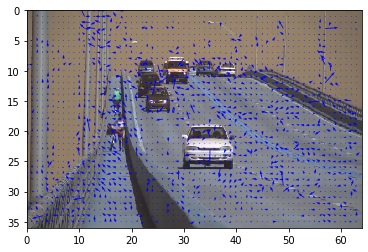

In [61]:
from scipy.ndimage.filters import convolve as filter2
import random

def flow(img1, img2, lambda_1, max_iter):
    # declare mean kernel, and kernels for computing gradients
    HSKERN = np.array([[1/9, 1/9, 1/9],
                   [1/9,    1/9, 1/9],
                   [1/9, 1/9, 1/9]], float)
    x_kernel = np.array([[-1,1],[-1,1]])
    y_kernel = np.array([[-1,-1],[1,1]])
    t_kernel_1 = np.array([[-1,-1],[-1,-1]])
    t_kernel_2 = np.array([[1,1],[1,1]])
    
    # typecast images as float
    img1 = img1.astype(np.float32)
    img2 = img2.astype(np.float32)
    
    # declare flow vector matrices as 0s
    u = np.zeros([img1.shape[0], img1.shape[1]])
    v = np.zeros([img1.shape[0], img1.shape[1]])
    
    # concolve the images with the kernels to compute the gradients
    conv1 = filter2(img1, x_kernel)
    conv2 = filter2(img2, x_kernel)
    fx = conv1 + conv2
    conv1 = filter2(img1, y_kernel)
    conv2 = filter2(img2, y_kernel)
    fy = conv1 + conv2
    conv1 = filter2(img1, t_kernel_2)
    conv2 = filter2(img2, t_kernel_1)
    ft = conv1 + conv2
    
    # loop to improve the estiamtion of the flow vectors
    for i in range(max_iter):
        # compute the mean by convolving the flow vector with the mean kernel
        u_mean = filter2(u, HSKERN)
        v_mean = filter2(v, HSKERN)
        # compute P and D and compute the flow vectors from P, D and the means
        P = fx*u_mean+fy*v_mean+ft
        D = lambda_1**2+fx**2+fy**2
        PD = P/D
        u = u_mean-fx*PD
        v = v_mean-fy*PD
        
    
#     hsv = np.zeros((u.shape[0],u.shape[1],3), np.uint8)
#     mag, ang = cv2.cartToPolar(u,v)
#     hsv[..., 0] = ang*180/np.pi/2
#     hsv[..., 1] = 255
#     hsv[..., 2] = cv2.normalize(mag, None, 0, 255, cv2.NORM_MINMAX)
#     rgb = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)
    
#     plt.figure()
#     plt.imshow(rgb, cmap='viridis')
#     plt.colorbar()
#     plt.show()

    return u, v

img2 = cv2.cvtColor(org_img2, cv2.COLOR_BGR2GRAY)
u, v = flow(img, img2, 2, 100)

# put None were flow is 0
u[np.where(u == 0)] = None
v[np.where(v == 0)] = None
# downsample the flow vector
h, w = img.shape
u = u[::10,::10]
v = v[::10,::10]
uh,uw = u.shape
# plot the quiver from the downsampled flow vectors
plt.figure()
plt.quiver(v, u, color = 'blue', angles='xy', scale_units='xy', scale=1.25)
plt.imshow(org_img1, aspect='auto', extent=(0,uw,uh,0),)
plt.show()

<function matplotlib.pyplot.show(*args, **kw)>

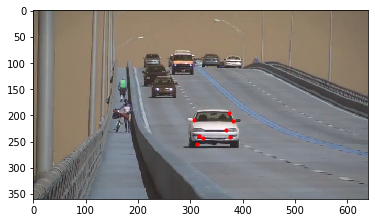

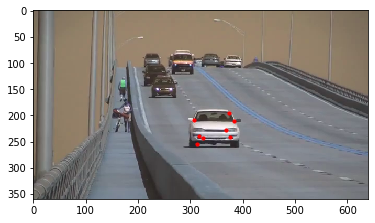

In [62]:
def tracking(img1, img2, features):
    # Compute optical flow using Horn and Schunck method
    U, V = flow(img1, img2, 2, 100)
    # Get image shape and declare allarrays needed
    h, w = img1.shape
    x_offset = []
    y_offset = []
    n_features = []
    n_x = []
    n_y = []
    
    # loop over the features and get the values for the flow vectors for each feature
    for feature in features:
         x_offset.append(np.rint(U[int(feature[1]), int(feature[0])]))
         y_offset.append(np.rint(V[int(feature[1]), int(feature[0])]))
    
    # change the numpy arrays and add the optical flow of the features to the coordinates of the features
    x_offset = np.array(x_offset)
    y_offset = np.array(y_offset)
    n_x = features[:,0] + x_offset
    n_y = features[:,1] + y_offset
    # Make the new x coordinates and y coordinates into 1 2D array
    n_features = np.column_stack((n_x, n_y))
    # Check for features that are out of the boundaries of the image and delete them
    k = 0
    for feature in n_features:
        if feature[0] < 0 or feature[0] > w:
            n_features = np.delete(n_features, k, axis=1)
        elif feature[1] < 0 or feature [1] > h:
            n_features = np.delete(n_features, k, axis=1)
        
        k = k+1
    
    return n_features

# Compute tracking between the first 2 frames
new_features = tracking(img, img2, centr)

# show the first image with the features, and the second image with the new features
plt.figure()
plt.imshow(org_img1)
plt.scatter(x=centr[:,0], y=centr[:,1], c='r', marker='o', s=10)
plt.show

plt.figure()
plt.imshow(org_img2)
plt.scatter(x=new_features[:,0], y=new_features[:,1], c='r', marker='o', s=10)
plt.show

div by 0
div by 0
1


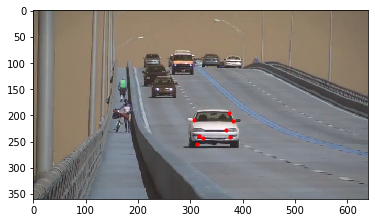

2


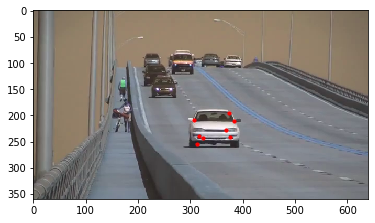

3


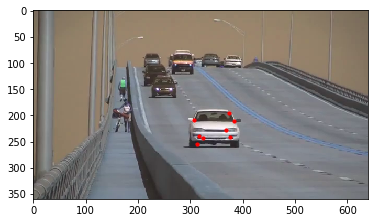

4


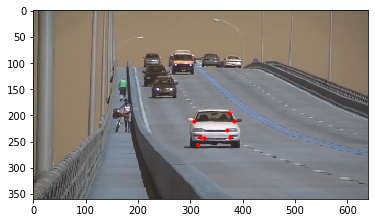

5


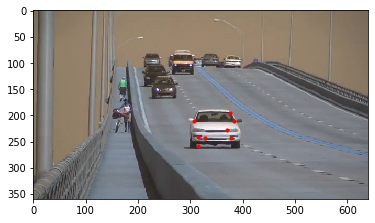

6


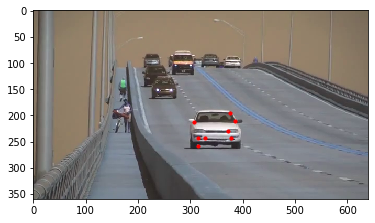

7


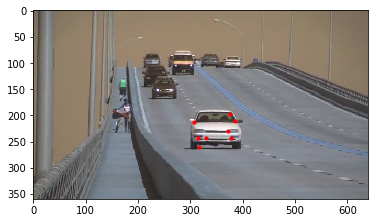

8


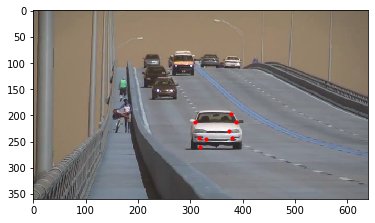

9


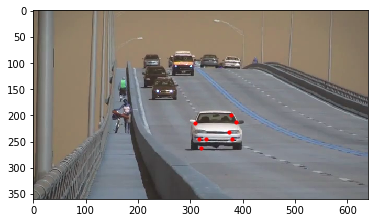

10


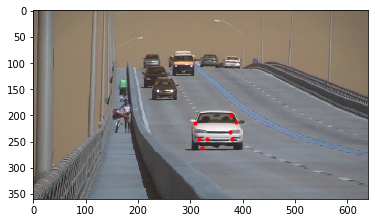

11


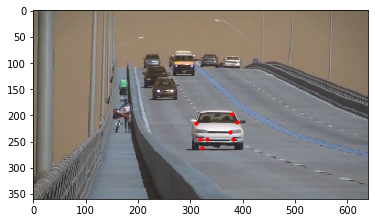

12


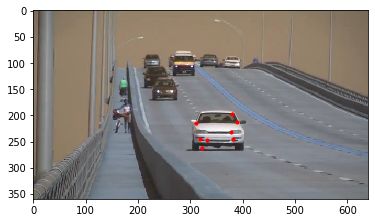

13


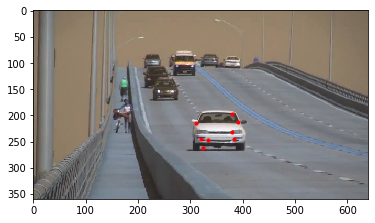

14


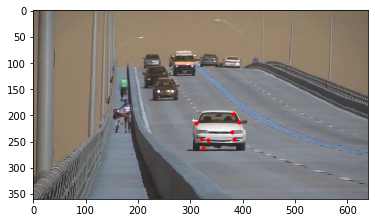

15


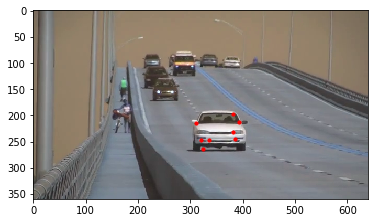

16


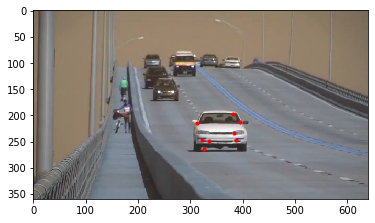

17


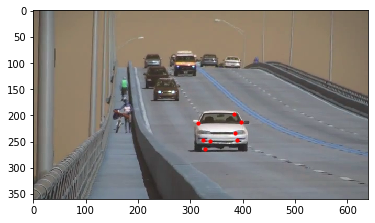

18


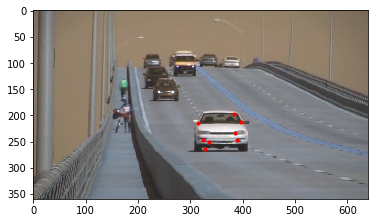

19


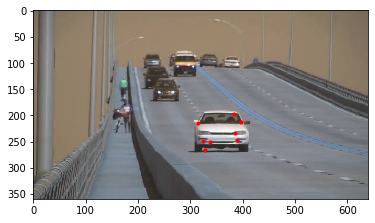

20


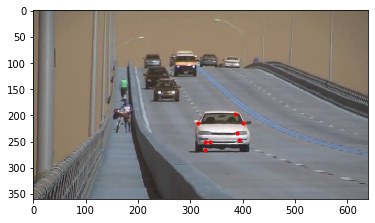

21


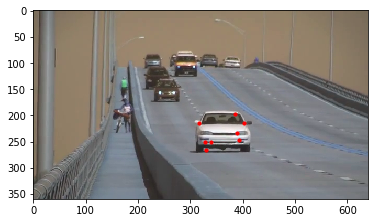

22


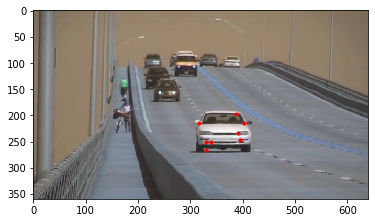

23


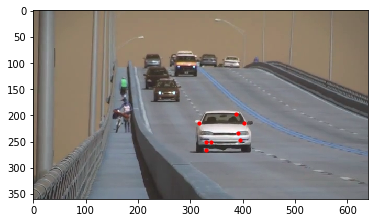

24


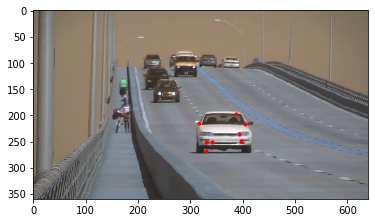

25


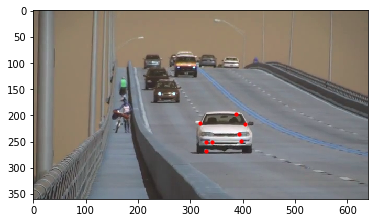

26


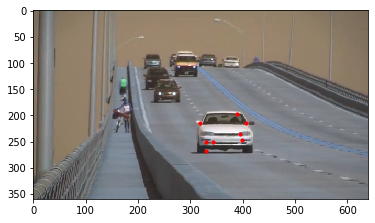

27


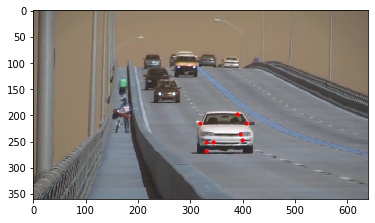

28


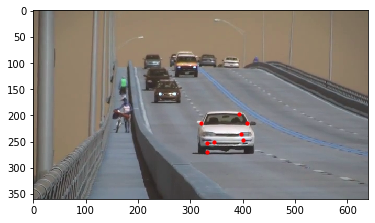

29


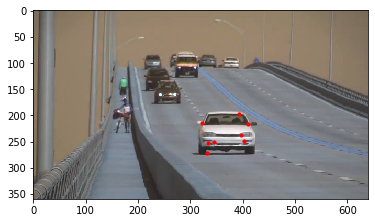

30


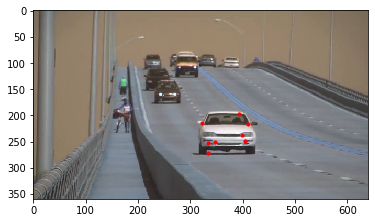

31


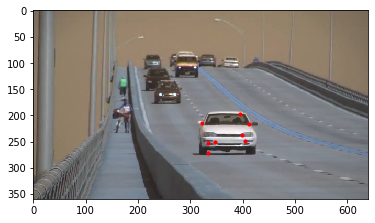

32


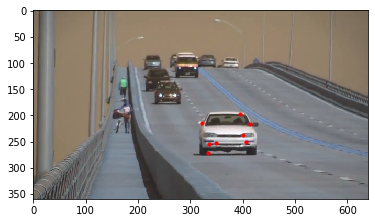

33


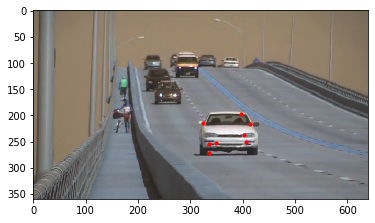

34


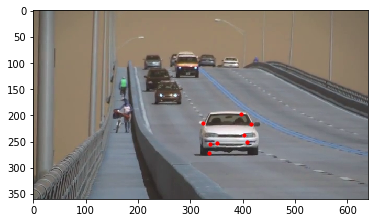

35


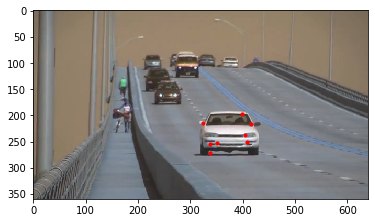

36


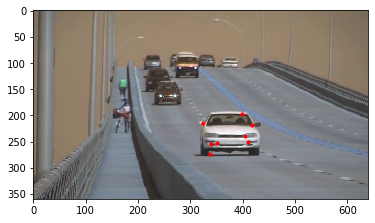

37


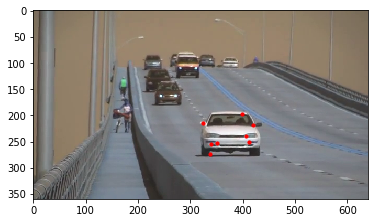

38


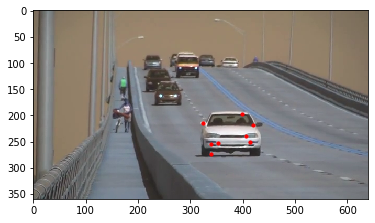

39


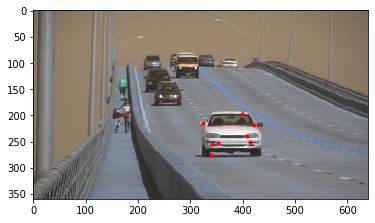

40


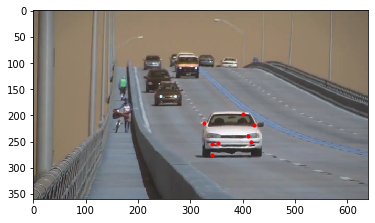

41


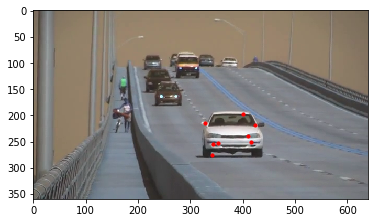

42


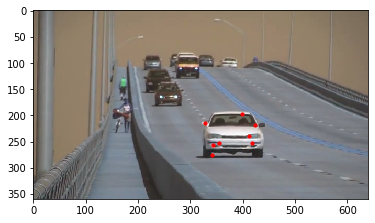

43


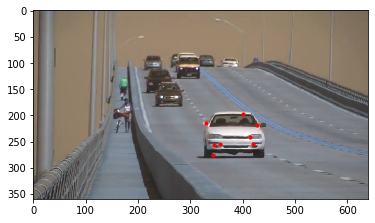

44


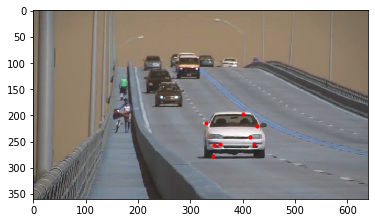

45


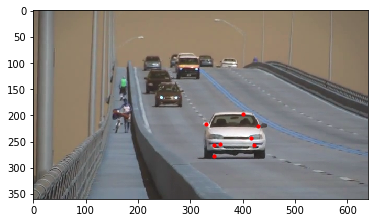

46


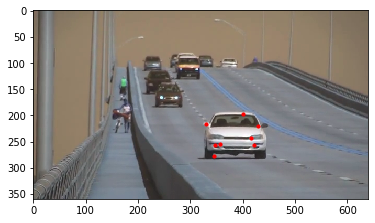

47


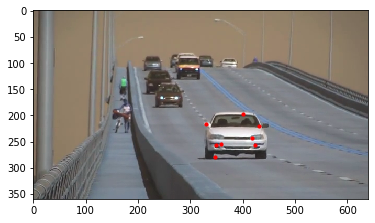

48


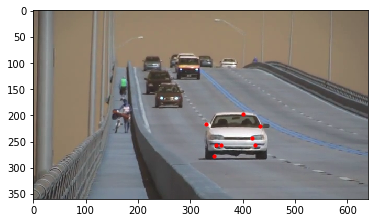

49


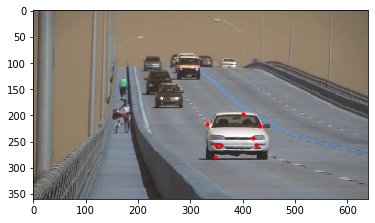

50


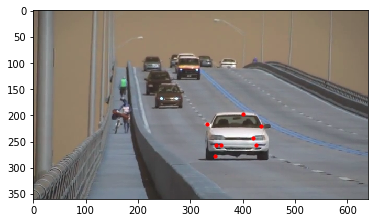

51


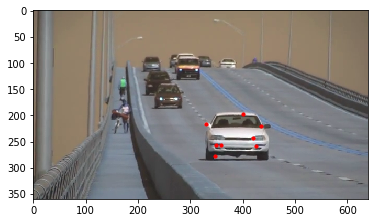

52


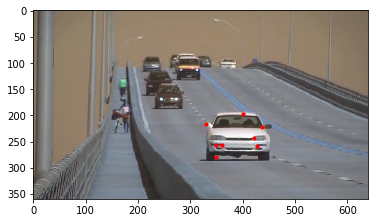

53


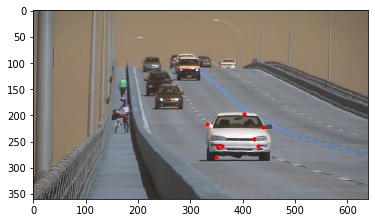

54


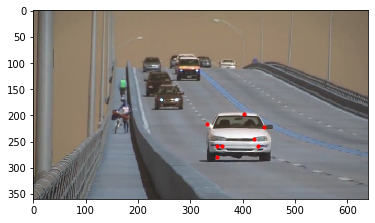

55


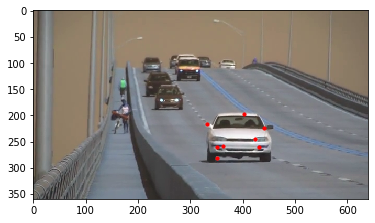

56


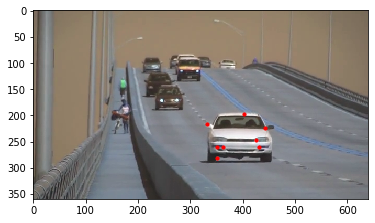

57


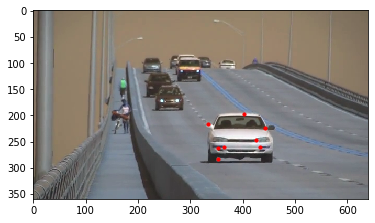

58


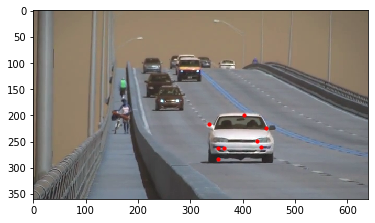

59


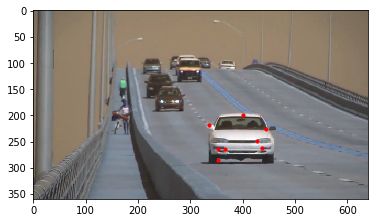

60


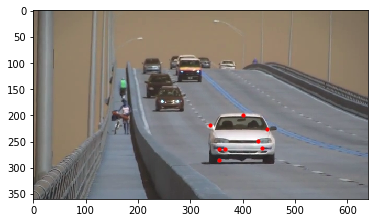

61


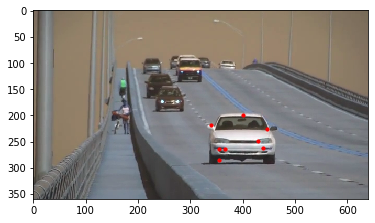

62


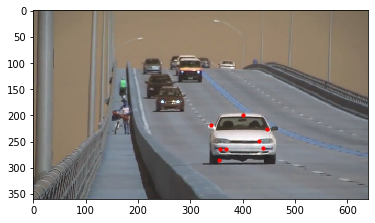

63


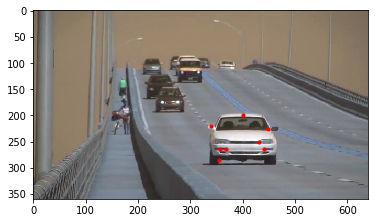

64


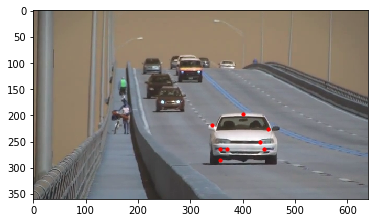

65


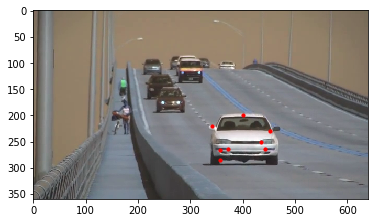

66


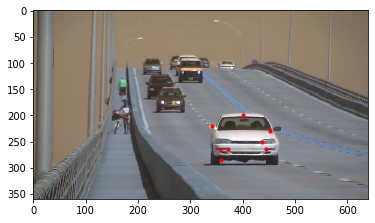

67


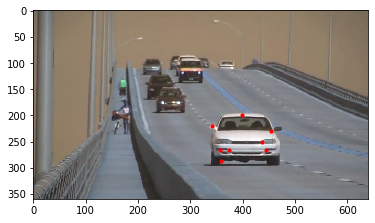

68


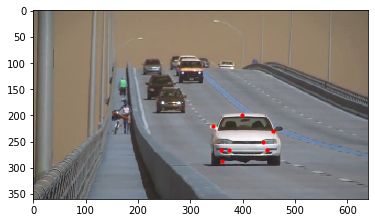

69


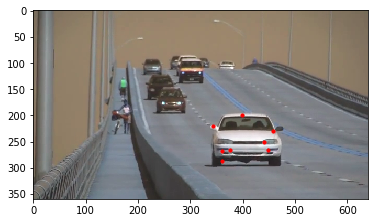

70


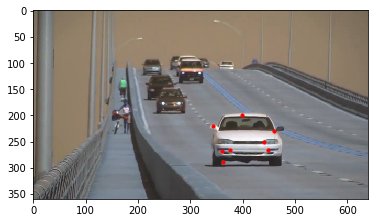

71


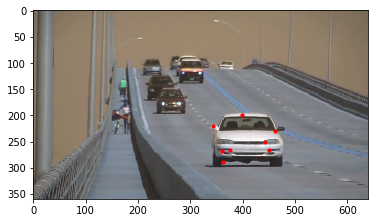

72


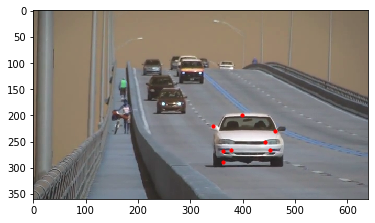

73


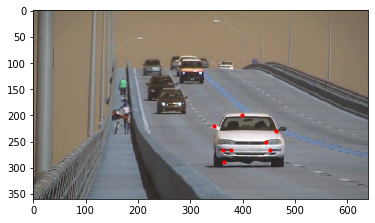

74


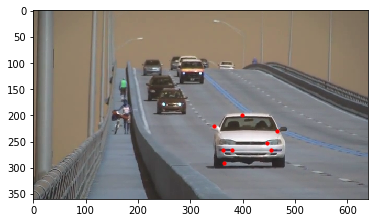

75


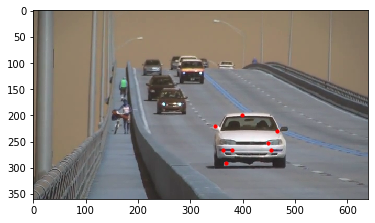

76


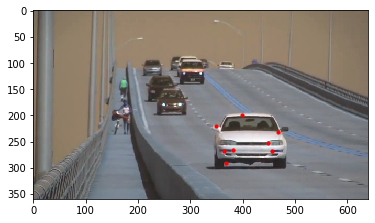

77


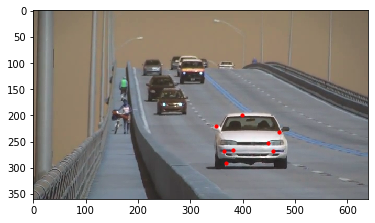

78


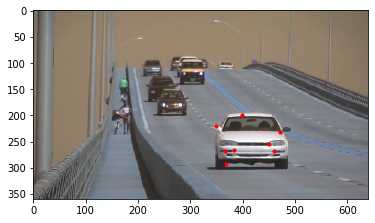

79


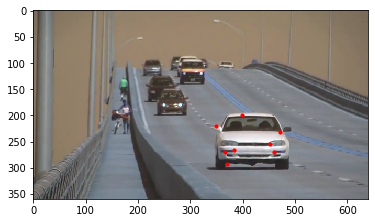

80


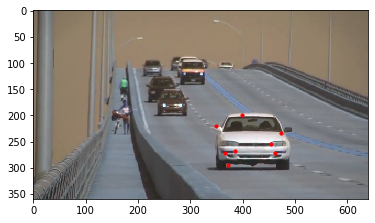

81


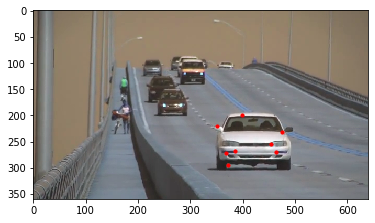

82


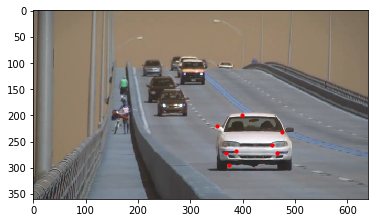

83


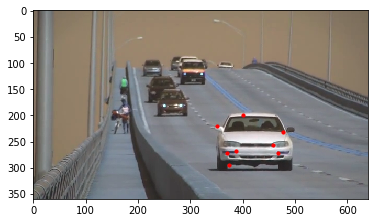

84


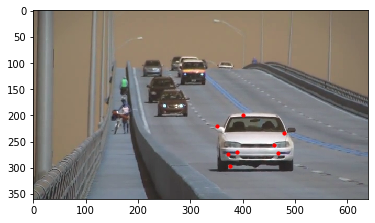

85


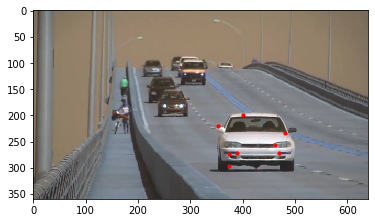

86


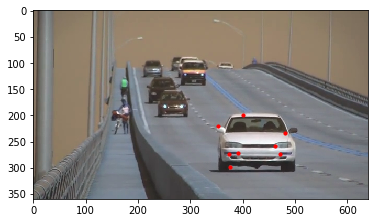

87


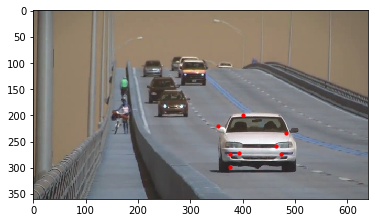

88


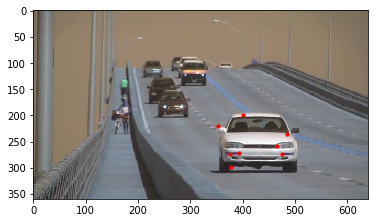

89


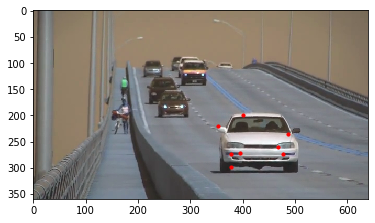

90


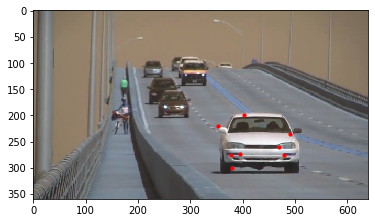

91


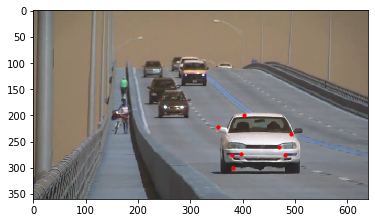

92


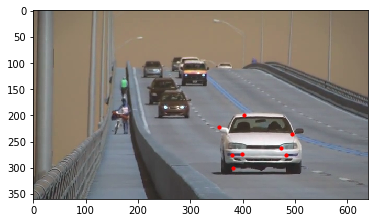

93


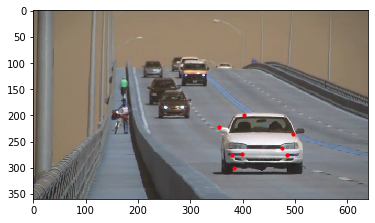

94


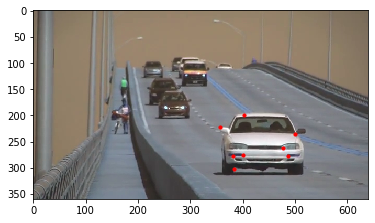

95


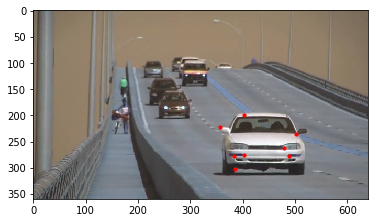

96


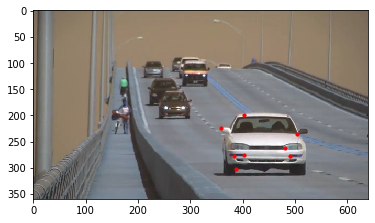

97


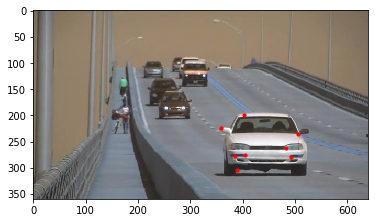

98


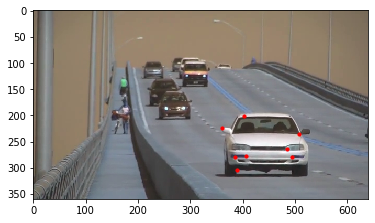

99


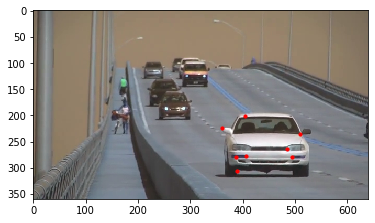

100


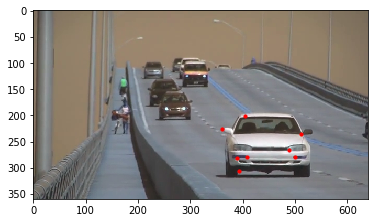

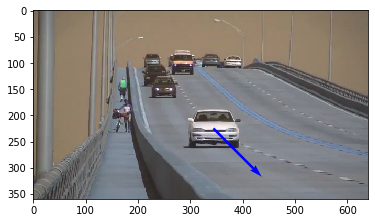

In [63]:
# function to calculate centre from given coordinates
def centre(x,y):
    cntr_x = ((max(x)-min(x))/2) + min(x)
    cntr_y = ((max(y)-min(y))/2) + min(y)
    return [cntr_x, cntr_y]

# Remove if there is any open video
video.release()
cv2.destroyAllWindows()

# declare the bounding box of the white vehicle in the first frame
box_tr = (291, 181)
box_br = (399, 261)

# open video for tracking
video = cv2.VideoCapture('traffic.mp4')
if (video.isOpened()== False): 
  print("Error opening video stream or file")

# loop over the first 100 frames
for i in range(0,100):
    
    if i is 0:
        # read the first frame
        success, org_img2 = video.read()
        org_img = org_img2
        # Check if frame is read successfully
        if success:
            # convert the frame into grayscale, get the segment which contains the white car and compute Harris Corner Detection
            img = cv2.cvtColor(org_img2, cv2.COLOR_BGR2GRAY)
            img_seg = img[box_tr[1]:box_br[1],box_tr[0]:box_br[0]]
            centr = HarrisCornerDetection(img_seg)
            # transpose the keypoints detected
            centr[:,0] = centr[:,0] + box_tr[0]
            centr[:,1] = centr[:,1] + box_tr[1]
            # print the frame number
            print(i+1)
            # Compute the centre of the features (to be used for outputting the trajectory)
            centre1 = centre(centr[:,0],centr[:,1])
            # Display the First frame with the obtained keypoints
            plt.figure()
            plt.imshow(org_img2)
            plt.scatter(x=centr[:,0], y=centr[:,1], c='r', marker='o', s=10)
            plt.show()
        else:
            print("Error in getting image from video file")
    else:
        # Make the first frame as img1, and obtain the second frame as img2
        org_img1 = org_img2
        success, org_img2 = video.read()
        # Check if there was an error in reading the new frame
        if not success:
            print("Error in getting image from video file")
        # change both frames into grayscale
        img1 = cv2.cvtColor(org_img1, cv2.COLOR_BGR2GRAY)    
        img2 = cv2.cvtColor(org_img2, cv2.COLOR_BGR2GRAY)
        # print the frame number
        print(i+1)
        # get the new tracked feature location
        new_features = tracking(img1, img2, centr)
        centr = new_features
        # plot the new frame with the tracked features
        plt.figure()
        plt.imshow(org_img2)
        plt.scatter(x=centr[:,0], y=centr[:,1], c='r', marker='o', s=10)
        plt.show()

# compute the centre of the last frame's keypoints
centre2 = centre(centr[:,0],centr[:,1])
# compute the change between the centre in frame 1 and frame 100 and plot the trajectory using quiver
change_x = centre2[0]-centre1[0]
change_y = centre2[0]-centre1[0]
plt.figure()
plt.imshow(org_img)
plt.quiver(centre1[0], centre1[1], change_x, change_y, color = 'b', angles='xy', scale_units='xy', scale=1)
plt.show()

video.release()
cv2.destroyAllWindows()

div by 0
div by 0
1


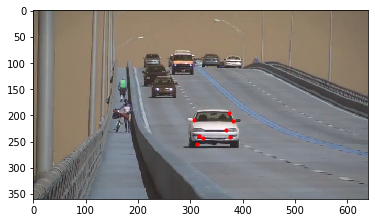

2


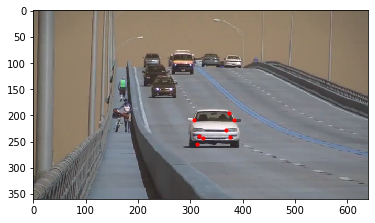

3


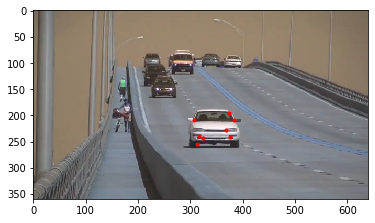

4


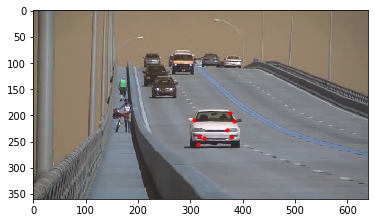

5


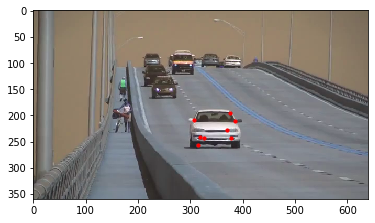

6


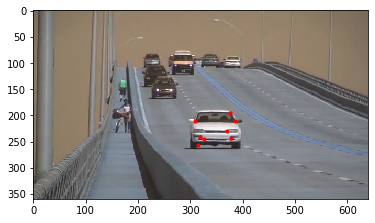

7


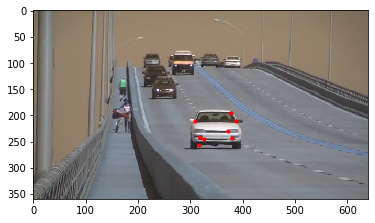

8


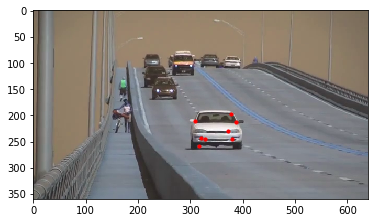

9


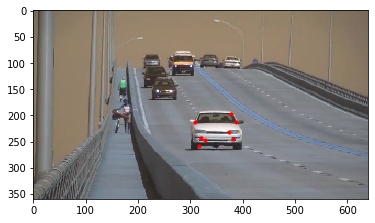

10


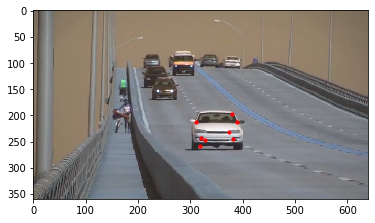

11


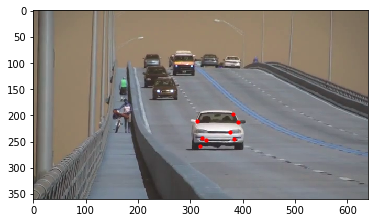

12


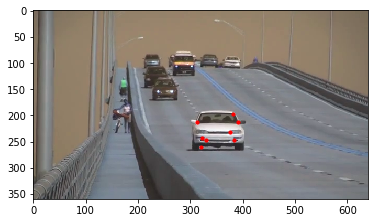

13


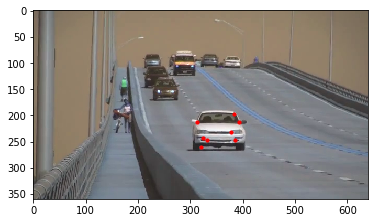

14


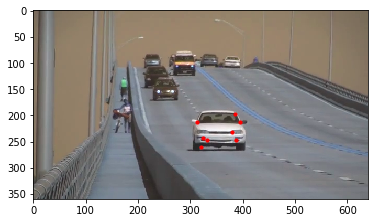

15


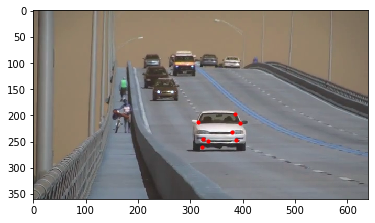

16


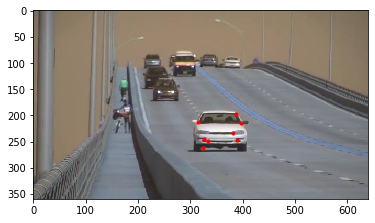

17


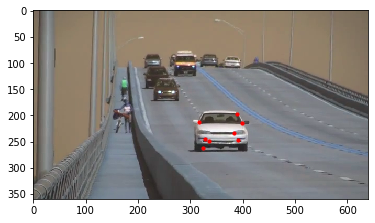

18


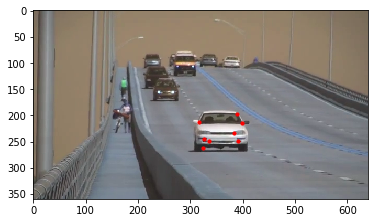

19


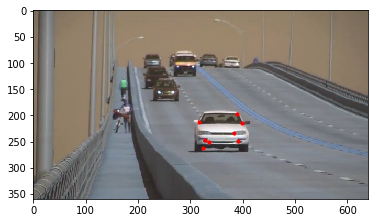

20


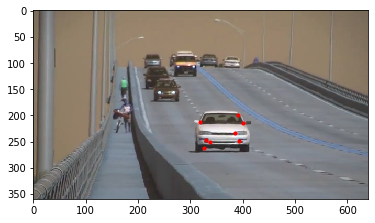

21


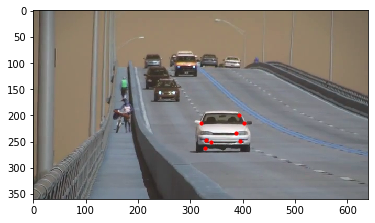

22


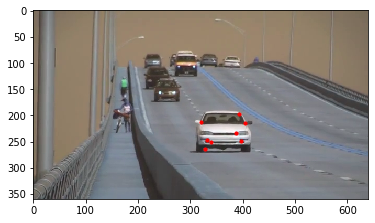

23


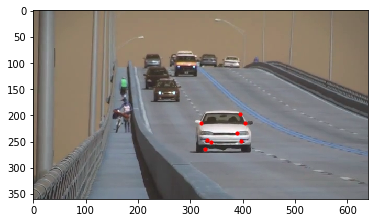

24


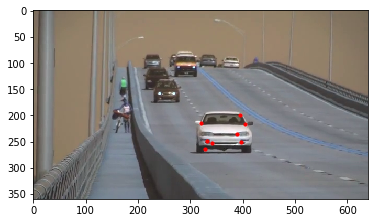

25


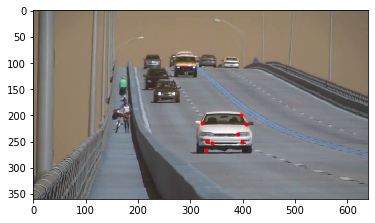

26


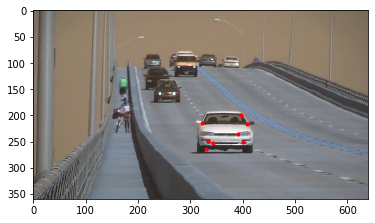

27


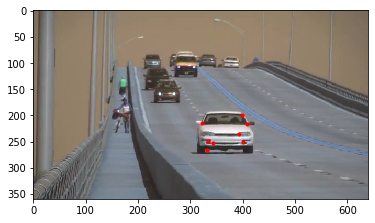

28


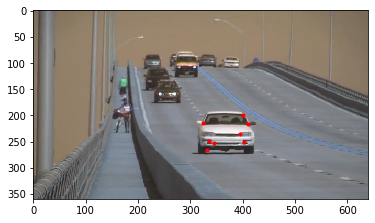

29


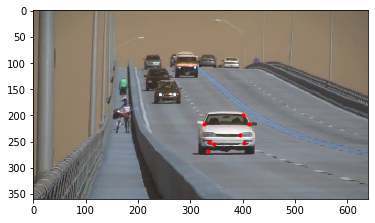

30


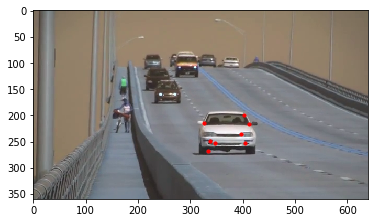

31


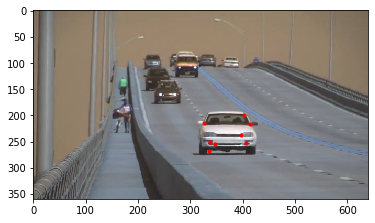

32


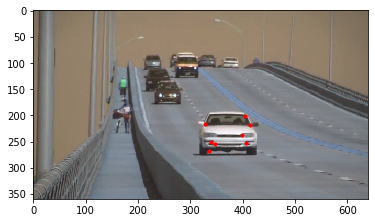

33


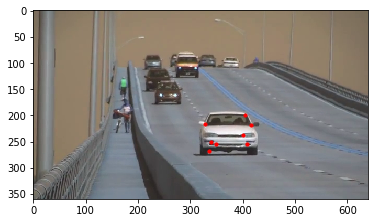

34


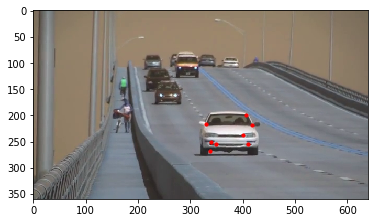

35


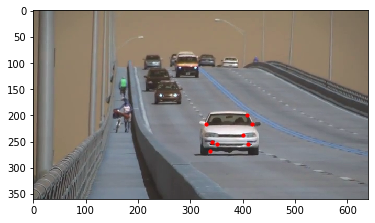

36


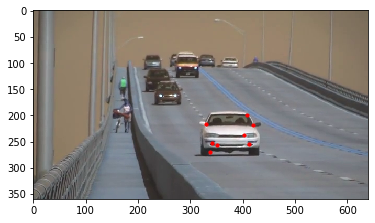

37


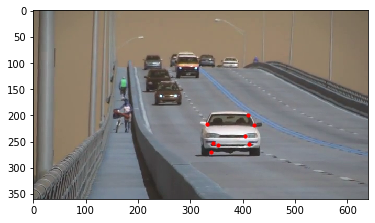

38


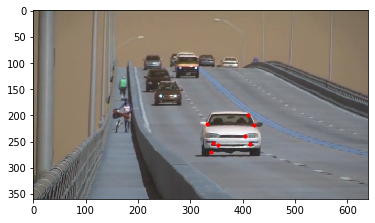

39


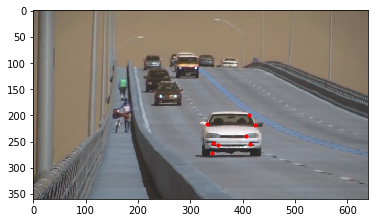

40


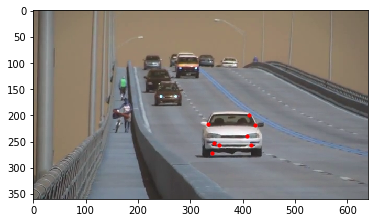

41


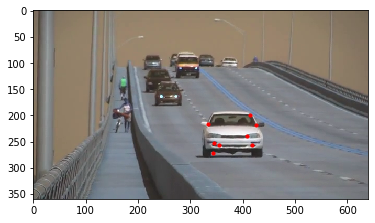

42


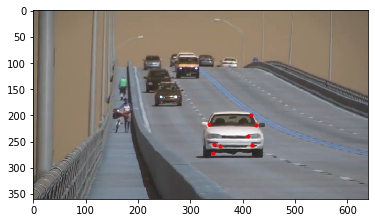

43


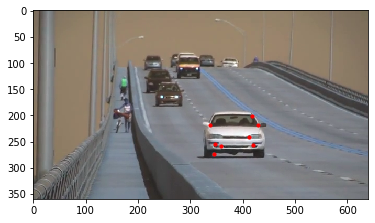

44


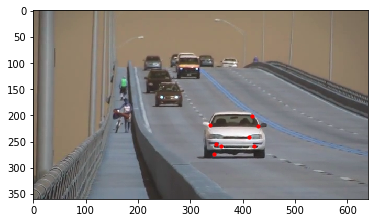

45


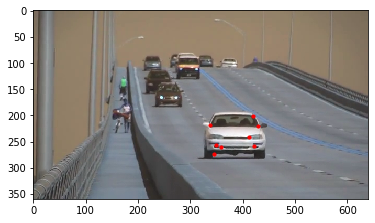

46


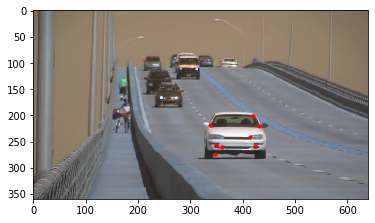

47


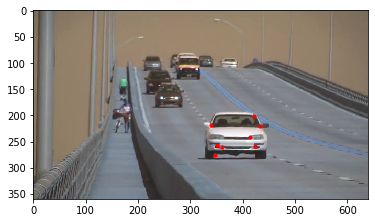

48


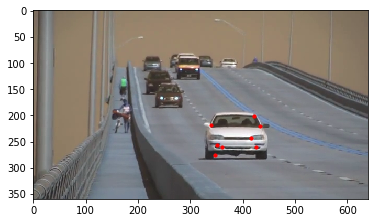

49


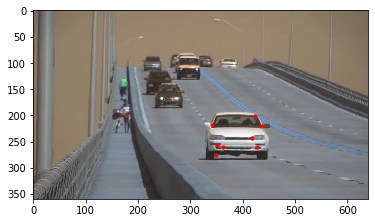

50


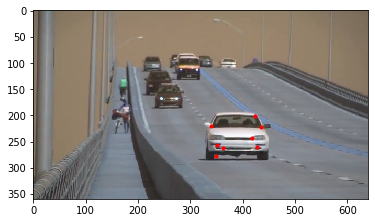

51


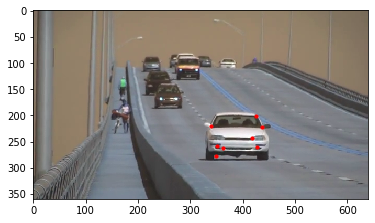

52


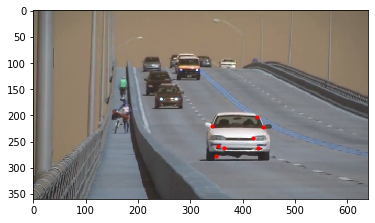

53


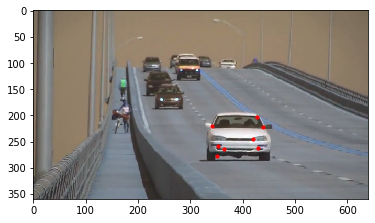

54


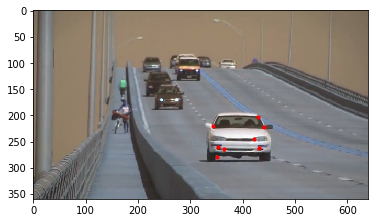

55


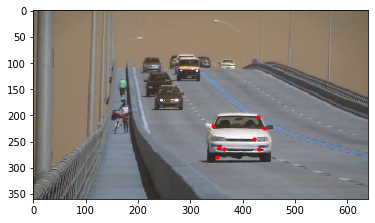

56


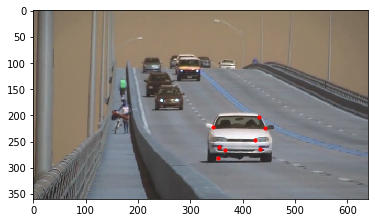

57


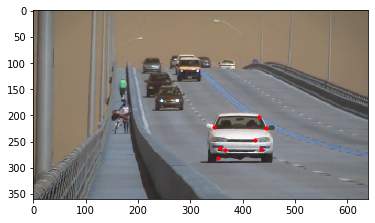

58


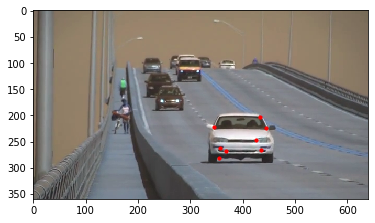

59


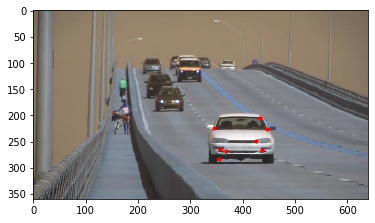

60


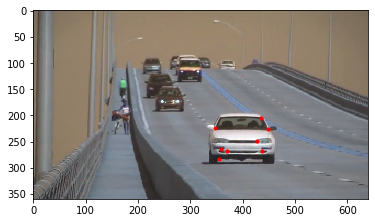

61


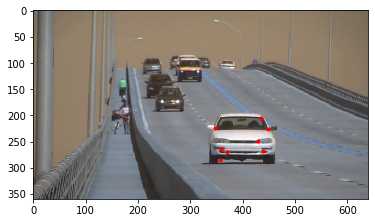

62


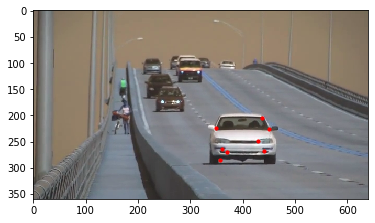

63


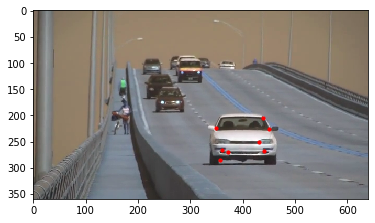

64


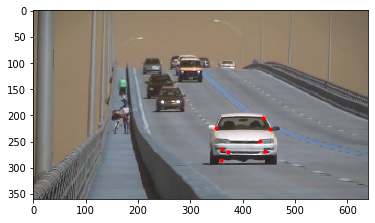

65


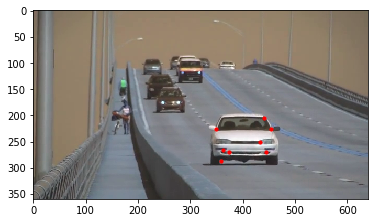

66


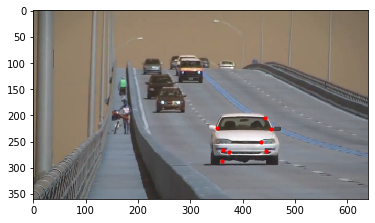

67


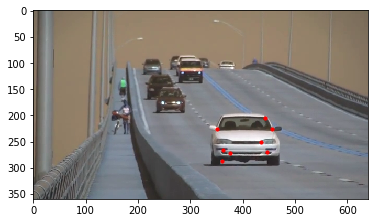

68


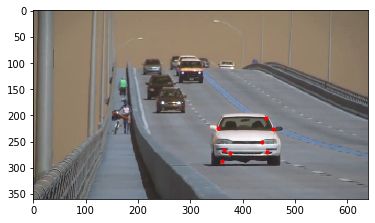

69


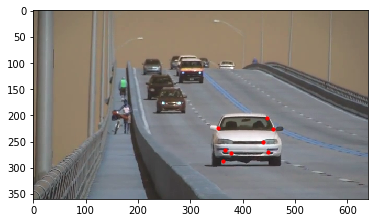

70


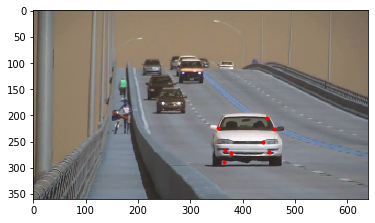

71


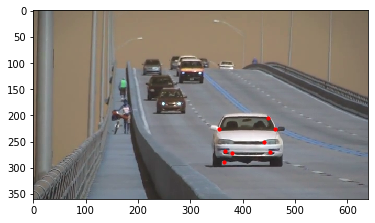

72


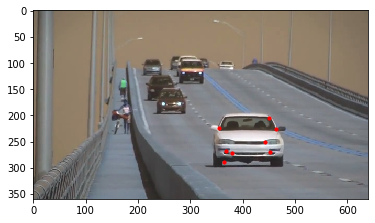

73


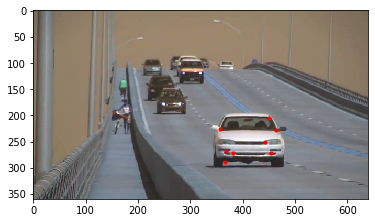

74


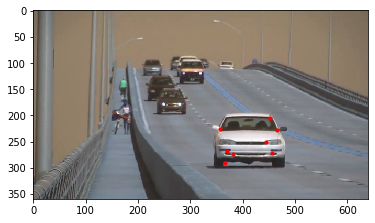

75


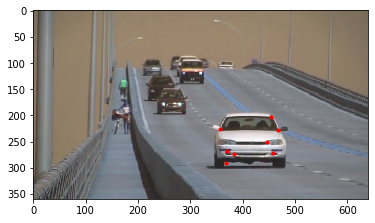

76


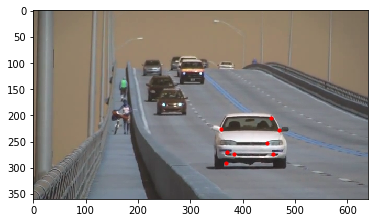

77


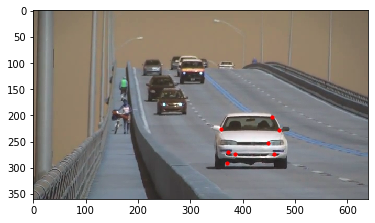

78


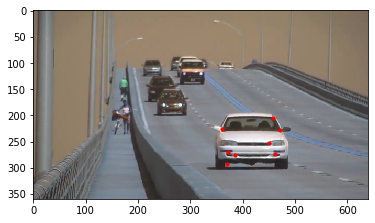

79


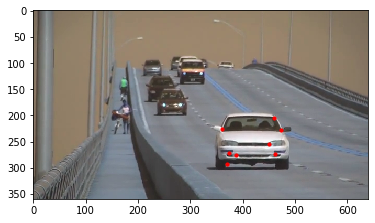

80


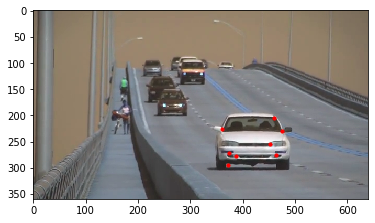

81


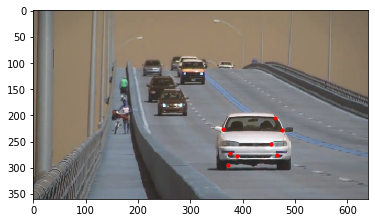

82


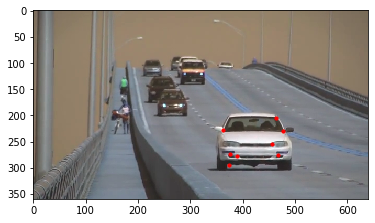

83


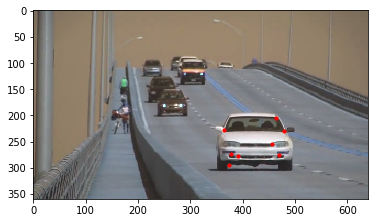

84


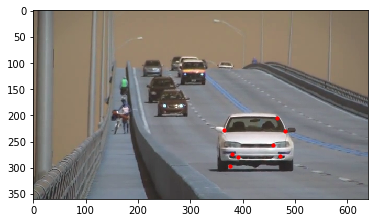

85


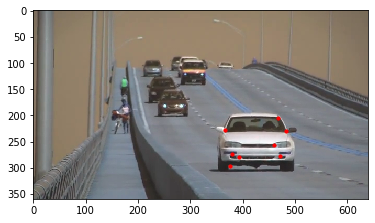

86


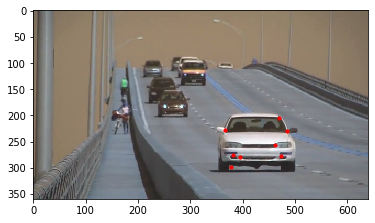

87


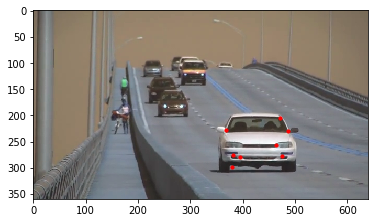

88


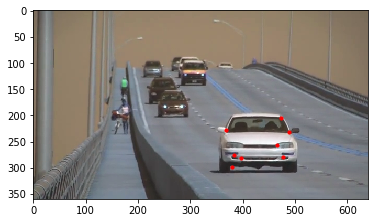

89


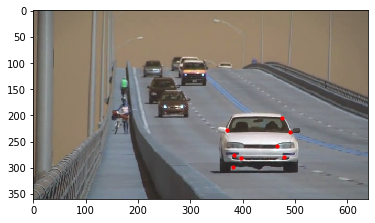

90


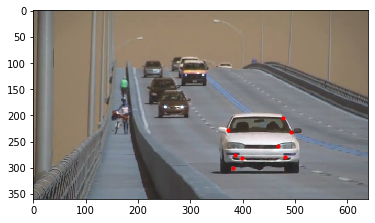

91


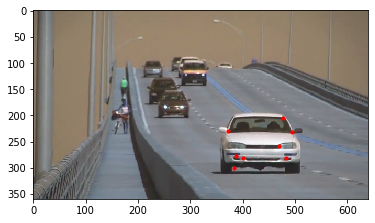

92


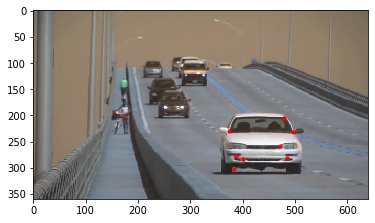

93


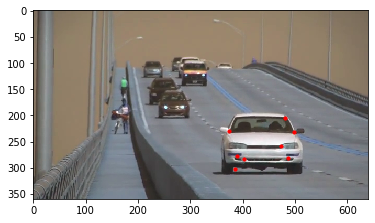

94


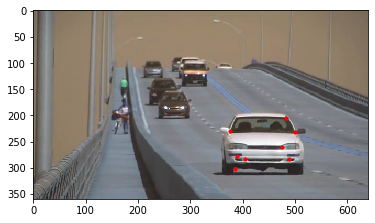

95


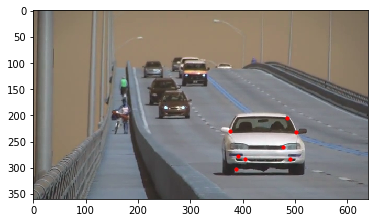

96


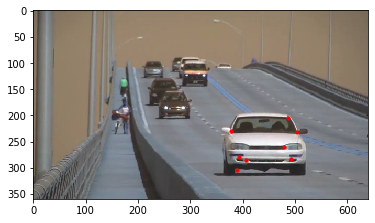

97


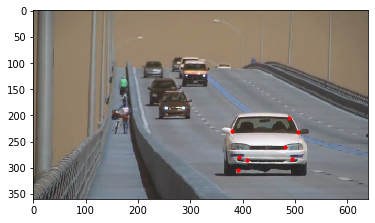

98


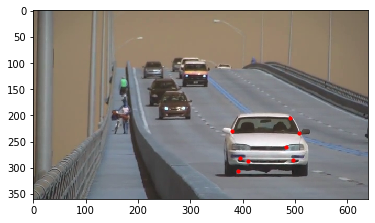

99


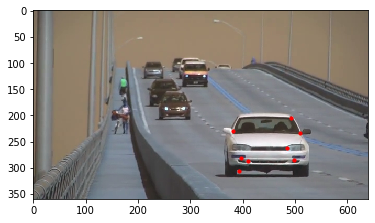

100


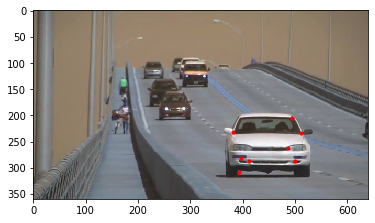

In [65]:
# Remove if there is any open video
video.release()
cv2.destroyAllWindows()

# declare the bounding box of the white vehicle in the first frame
box_tr = (291, 181)
box_br = (399, 261)

# open video for tracking
video = cv2.VideoCapture('traffic.mp4')
if (video.isOpened()== False): 
  print("Error opening video stream or file")

# loop over the first 100 frames
for i in range(0,100):
    
    if i is 0:
        # read the first frame
        success, org_img2 = video.read()
        # Check if frame is read successfully
        if success:
            # convert the frame into grayscale, get the segment which contains the white car and compute Harris Corner Detection
            img = cv2.cvtColor(org_img2, cv2.COLOR_BGR2GRAY)
            img_seg = img[box_tr[1]:box_br[1],box_tr[0]:box_br[0]]
            centr = HarrisCornerDetection(img_seg)
            # declare a numpy array with the correct format required for opencv tracking
            centr1 = np.empty([0, 1, 2], dtype=np.float32)
            # transpose the keypoints detected
            centr[:,0] = centr[:,0] + box_tr[0]
            centr[:,1] = centr[:,1] + box_tr[1]
            # covert the feature array into the correct format for opencv tracking
            for cent in centr:
                centr1 = np.append(centr1, np.array([[[cent[0],cent[1]]]]), axis=0)
            # ensure that the array is of datatype float32
            centr1=np.array(centr1, dtype=np.float32)
            # print the frame number
            print(i+1)
            # plot the new frame with the tracked features
            plt.figure()
            plt.imshow(org_img2)
            plt.scatter(x=centr1[:,:,0], y=centr1[:,:,1], c='r', marker='o', s=10)
            plt.show()
        else:
            print("Error in getting image from video file")
    else:
        # Make the first frame as img1, and obtain the second frame as img2
        org_img1 = org_img2
        # Check if there was an error in reading the new frame
        success, org_img2 = video.read()
        if not success:
            print("Error in getting image from video file")
        # change both frames into grayscale
        img1 = cv2.cvtColor(org_img1, cv2.COLOR_BGR2GRAY)    
        img2 = cv2.cvtColor(org_img2, cv2.COLOR_BGR2GRAY)
        # print the frame number
        print(i+1)
        # get the new tracked feature location with OpenCV implementation
        new_features, st, err = cv2.calcOpticalFlowPyrLK(img1, img2, centr1, None)
        centr1 = new_features
        # plot the new frame with the tracked features
        plt.figure()
        plt.imshow(org_img2)
        plt.scatter(x=centr1[:,:,0], y=centr1[:,:,1], c='r', marker='o', s=10)
        plt.show()

video.release()
cv2.destroyAllWindows()